## Sample Script for 1 df


TODO: read Prediction of pain using electrocardiographic-derived autonomic measures: A systematic review

interesting signal quality assessment: https://github.com/HealthSciTech/E2E-PPG

In [1]:
from pathlib import Path
if Path.cwd().stem == 'physiology':
    %cd ../../..
    %load_ext autoreload
    %autoreload 2

In [2]:
import os
from pathlib import Path
from functools import reduce
from dataclasses import dataclass
from typing import Dict, List
import logging

import numpy as np
import pandas as pd
import polars as pl
import neurokit2 as nk

from src.data.process_data import load_participant_datasets, load_dataset
from src.data.quality_check import check_sample_rate
from src.data.transform_data import apply_func_participant
from src.data.config_data import DataConfigBase
from src.data.config_data_imotions import iMotionsConfig, IMOTIONS_LIST
from src.data.config_data_raw import RawConfig, RAW_LIST, RAW_DICT
from src.data.config_participant import ParticipantConfig, PARTICIPANT_LIST

from src.log_config import configure_logging
configure_logging(color=True, stream_level=logging.DEBUG, ignore_libs=['matplotlib'])

pl.Config.set_tbl_rows(7); # don't print too many rows in the book

In [3]:
raw = load_dataset(PARTICIPANT_LIST[1], RAW_DICT['ecg']).dataset
check_sample_rate(raw)
check_sample_rate(raw, unique_timestamp=True)
raw

21:33:24 | DEBUG   | process_data | Dataset 'ecg' for participant 003_pilot_noah loaded from data/raw/003_pilot_noah/003_pilot_noah_ecg.csv
21:33:24 | DEBUG   | quality_check | Sample rate per trial: [927.26 936.64 899.89]
21:33:24 | INFO    | quality_check | The mean sample rate is 921.26.
21:33:24 | WARNING | quality_check | Sample rate varies more than 0.5% between trials: 2.07% (coefficient of variation).
21:33:24 | DEBUG   | quality_check | Sample rate per trial: [91.85 93.11 88.87]
21:33:24 | INFO    | quality_check | The mean sample rate is 91.27.
21:33:24 | WARNING | quality_check | Sample rate varies more than 0.5% between trials: 2.39% (coefficient of variation).


Timestamp,ECG_LL-RA,ECG_LA-RA,ECG_Vx-RL,ECG_LL-RA_HeartRate,ECG_LL-RA_IBI,Trial
f64,f64,f64,f64,f64,f64,f64
27518.1013,36.475514,12.594961,-601.935768,57.798683,-1.0,0.0
27518.1013,36.50292,12.627055,-601.933605,57.798683,-1.0,0.0
27518.1013,36.525278,12.64797,-601.920623,57.798683,-1.0,0.0
…,…,…,…,…,…,…
912480.211,28.236339,4.58333,-602.420426,57.798683,-1.0,2.0
912480.211,28.233093,4.588017,-602.412853,57.798683,-1.0,2.0
912480.211,28.225881,4.566742,-602.406723,57.798683,-1.0,2.0


In [4]:
raw.plot(x='Timestamp', y='ECG_LL-RA')

:Curve   [Timestamp]   (ECG_LL-RA)

<Axes: >

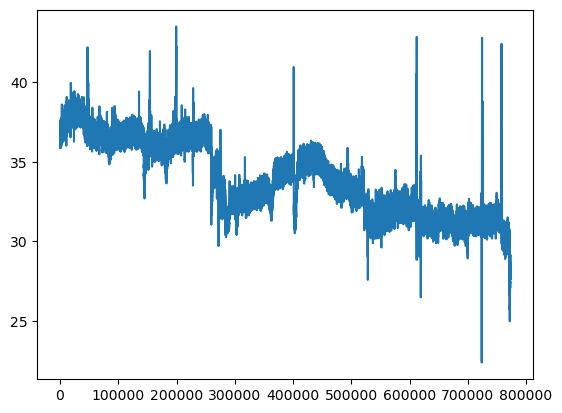

In [5]:
raw = raw.to_pandas()
ecg = raw['ECG_LL-RA']
ecg.plot()

In [6]:
processed_ecg, info = nk.ecg_process(ecg, sampling_rate=500)
processed_ecg.ECG_Quality.mean()

0.9315659764550684

In [7]:
import neurokit2 as nk


ecg = df_stimuli['ECG LL-RA CAL'].dropna()
ecg
processed_ecg, info = nk.ecg_process(ecg, sampling_rate=500)
# Plot
nk.ecg_plot(processed_ecg, info=info)
fig = plt.gcf()
fig.set_size_inches(10, 12, forward=True)
processed_ecg.ECG_Quality.mean()

NameError: name 'df_stimuli' is not defined

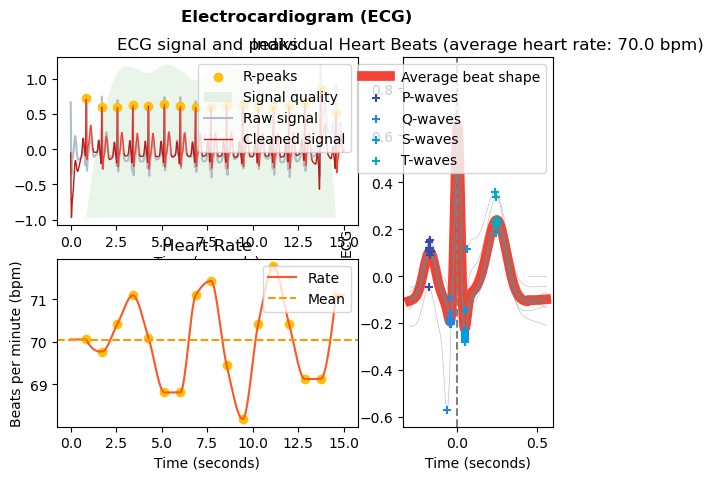

In [ ]:
# Generate 15 seconds of ECG signal (recorded at 250 samples/second)
ecg = nk.ecg_simulate(duration=15, sampling_rate=250, heart_rate=70)

# Process it
signals, info = nk.ecg_process(ecg, sampling_rate=250)

# Visualise the processing
nk.ecg_plot(signals, info)

In [ ]:
signals = nk.ecg_clean(ecg, sampling_rate=500, method='neurokit')
nk.ecg_quality(
    signals, rpeaks=None, 
    sampling_rate=512, 
    method="zhao2018", 
    approach="fuzzy")


'Barely acceptable'